In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from __future__ import print_function
import numpy as np
from tqdm import tqdm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
from matplotlib import cm
plt.rcParams.update({'font.size': 14, 'lines.markersize' : 4})

from scipy.optimize import curve_fit
import sys, os
import time, datetime
from datetime import timedelta
import pandas as pd
sys.path.append('/reg/d/psdm/tmo/tmox51020/results/paris/recon')
from recon_funcs import *
import h5py

/reg/neh/home/tdd14/modules/CPBASEX/pbasex-Python/pbasex/gData.py:55: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if gData['rBF'] is not 'custom':


Hi! I imported. 


In [3]:
from matplotlib import cm
from matplotlib.colors import ListedColormap
my_cmap = cm.get_cmap('jet')
xr = np.linspace(0, 1, 2000)
my_cmap = my_cmap(xr)
my_cmap[0][-1] = 0
my_cmap = ListedColormap(my_cmap)

In [24]:
def make_MM(x0):
    xshift, yshift =  x0[8], x0[9] 

    # Coordinates that you want to Perspective Transform
    pts1 = np.float32([[0,0],\
                       [0,1024],\
                       [1024,0],\
                       [1024, 1024]])


    # Size of the Transformed Image
    pts2 = np.float32([[0+xshift-x0[0],0 + yshift-x0[1]],\
                       [0+xshift-x0[2],1024 + yshift-x0[3]],\
                       [1024+xshift-x0[4],0 + yshift-x0[5]],\
                       [1024+xshift-x0[6],1024 + yshift-x0[7]]])

    MM = cv2.getPerspectiveTransform(pts1,pts2)
    return MM

X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskhm=np.zeros((1024,1024))
maskhm[(rs>120) & (rs<420)]=1
nmask = np.reshape(rebin(rebin(maskhm,4),4),[64**2,])


x,y, = 530,512
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-x)**2+(Y-y)**2)
mask=np.zeros((1024,1024))
mask[rs>1*48]=1

nmask = np.reshape(rebin(rebin(maskhm,4),4),[64**2,]) #rebin later
nnmask = (rebin(np.reshape(nmask, [64,64]))).flatten()
nnmask = rebin(rebin(maskhm,4),4)
#nnmask = (rebin(np.reshape(nmask, [64,64])*(inbg))).flatten()
nnmask[nnmask<0.5] = 0
nnmask[nnmask>=0.5] = 1

maskscale = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskscale [(rs>120) & (rs<270)]=1

def make_quads(x0):
    quads=np.ones((1024,1024))
    quads[:512,:512]= x0[0]
    quads[:512,512:]= x0[1]
    quads[512:,:512]= x0[2]
    quads[512:,512:]= x0[3]
    return quads


In [25]:
PR = PolarRebin('/reg/d/psdm/tmo/tmox51020/results/paris/recon/PR_c32_r32_th32.h5') 

gasoff = np.load('/reg/d/psdm/tmo/tmox51020/results/paris/recon/gas_off_X510_112.npy')
inner_bg = np.load('/reg/d/psdm/tmo/tmox51020/results/paris/recon/inner_bg2.npy')
gasoff = np.load('/reg/d/psdm/tmo/tmox51020/results/paris/recon/gas_off_X510_112.npy')
inner_bg = np.load('/reg/d/psdm/tmo/tmox51020/results/paris/recon/inner_bg2.npy')

resid = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/resid_bg_run110_2.npy') #np.load('/cds/home/p/paris/reconVMI_clean/resid_bg_mfgf10_unsat5.npy')
residold = np.load('/cds/home/p/paris/reconVMI_clean/resid_bg_mfgf10.npy')
#for background cal
ims_bg = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Aug/bg_for_cal.npy')
thresh = 32
gfsig = 0.985 #0.985 #0.875
 #int(sys.argv[7])
gfcart = 0.25 #applied to the simulated image to try to make it match the measured
mfcart = 1

In [58]:
runnum = 112
thresh = 32
MM = make_MM([-17.998,-2.74, 17.9, -17.39, 17.86, 8.52, -3.85, 17.9, 11.47, 47.86])
resid = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/bg_run_112_Mar.npy')
quads = cv2.warpPerspective(make_quads([0.97,0.967,0.99,0.999]),MM,(1024,1024))

maskscale = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskscale[(rs>130) & (rs<220)]=1
maskscale[(Y>26*16) & (Y<38*16)]=0

maskscale = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskscale [(rs>120) & (rs<270)]=1

fanmask = np.ones((1024,1024))
# X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
# rs=np.sqrt((X-512)**2+(Y-512)**2)
# fanmask [(16*46.5<X) &(X<16*58) & (32*16<Y) & (Y<42*16)]=0

mfn = 25 
gfn = 15 
tt = np.array([4410466482935666616, 4410466483277240371, 4410466483602167976,
       4410466487221983517, 4410466487288568117, 4410466487363541328,
       4410466487455291761, 4410466487555168661, 4410466487563557272,
       4410466487796865516, 4410466488038431299, 4410466496044571713,
       4410466496277748885, 4410466496344464557, 4410466500189199731,
       4410466500547419636, 4410466509161603277, 4410466509494919493,
       4410466521962095847, 4410466522078749969, 4410466525815219632,
       4410466526464943770, 4410466526673217253, 4410466534479341723,
       4410466534670969056, 4410466547862973831, 4410466551532727822,
       4410466551741001305, 4410466551857655427, 4410466552082575060,
       4410466573846689349, 4410466594452913173, 4410466594694478956,
       4410466594902752439, 4410466598747487613, 4410466599730396895,
       4410466603933220902, 4410466607877964048, 4410466612513981171,
       4410466616008885051, 4410466616092115801, 4410466616225416073,
       4410466616733582400, 4410466616900174972, 4410466620736521535,
       4410466620753167685, 4410466625222723308, 4410466625389315880,
       4410466628825892699, 4410466629317412876, 4410466633770191277,
       4410466634070084121, 4410466637939722984, 4410466638006438656,
       4410466641834527680, 4410466651198312359, 4410466654584819656,
       4410466668401644880, 4410466671771506027, 4410466671804929399,
       4410466671896548760, 4410466672254768665, 4410466680352528440,
       4410466680819013856, 4410466684855376363, 4410466684972030485,
       4410466685513489112, 4410466689674894352, 4410466693294840965,
       4410466706362196223, 4410466715076649980, 4410466715318215763,
       4410466715459904646, 4410466715501454485, 4410466719921071658,
       4410466727627319228, 4410466728127096944, 4410466732255078812,
       4410466732713306689, 4410466741127474386, 4410466744847297899,
       4410466745005501860, 4410466745388756526, 4410466745605287548,
       4410466749133483728, 4410466749616615294, 4410466750007996427,
       4410466753386377257, 4410466753502900307, 4410466753519546457,
       4410466753627943040, 4410466758313898613, 4410466761967006454,
       4410466762749899792, 4410466766536307905, 4410466766694642938,
       4410466771014121067, 4410466784180828937, 4410466800900636708,
       4410466814050829500, 4410466860782982013, 4410466860891247524,
       4410466860991124424, 4410466861457740912, 4410466865519007108,
       4410466869746996948, 4410466870080182092, 4410466925753018715,
       4410466930289290010, 4410466981025037018, 4410467011094660277,
       4410467020358436984, 4410467041731039068, 4410467042022543301,
       4410467066956109577, 4410467093272092735, 4410467093405393007,
       4410467105780687856, 4410467106022122567, 4410467110141715824,
       4410467118580787210, 4410467118880680054, 4410467123391785516,
       4410467136200535625, 4410467144531472572, 4410467148692746740,
       4410467149450867461, 4410467157315318992, 4410467175126563668,
       4410467183348972960, 4410467187576962800, 4410467191937990768,
       4410467192021352590, 4410467200601981787, 4410467209016018412,
       4410467209574123189, 4410467213010700008, 4410467217463347337,
       4410467226635242539, 4410467239018794927, 4410467256255026532,
       4410467264735909901, 4410467273316539098, 4410467281855618456,
       4410467286316654396, 4410467286524796807, 4410467286616416168,
       4410467295147106915, 4410467311800461126, 4410467312416892964,
       4410467324617468774, 4410467337859543071, 4410467342037463389,
       4410467342112436600, 4410467354904540559, 4410467363985340688,
       4410467397842682780, 4410467428163571153, 4410467428171828692,
       4410467428513402447, 4410467436452958261, 4410467436502896711,
       4410467453881734703, 4410467453940061764, 4410467458601244720,
       4410467462862657932, 4410467488239378799, 4410467501615146584,
       4410467505126827686, 4410467509338302448, 4410467513666300260,
       4410467513749662082, 4410467513757919621, 4410467513891219893,
       4410467514007874015, 4410467518544276382, 4410467522414046317,
       4410467530828476158, 4410467539609514515, 4410467543854150505,
       4410467561507322292, 4410467587466396265, 4410467591877624827,
       4410467604569851886, 4410467613009185416, 4410467625459846692,
       4410467625509785142, 4410467630129418259, 4410467638543717028,
       4410467660217129460, 4410467664245103356, 4410467668872994012,
       4410467672859418069, 4410467677603962847, 4410467689813058340,
       4410467694240933052, 4410467694582375735, 4410467698993604297,
       4410467702663358288, 4410467702696781660, 4410467737419461408,
       4410467742038832381, 4410467754356193385, 4410467758759033336], dtype =np.uint64)

print(len(tt))
print(len(np.unique(tt)))

204
204


In [27]:
tt = tt[[33, 102, 114, 121, 127, 129, 139, 155, 169, 171, 175, 177, 184, 191, 194, 195, 202]]

In [59]:
cVMIs = []
rawish= []
detsum = []
maxim = []
cVMIsold = []
specs = []
unproc = []
gds = []
tmstmps = []

ds=ps.DataSource(exp = 'tmox51020', run= runnum, timestamps=tt)
#ds=ps.DataSource(exp = 'tmox51020', run= runnum, filter = lambda evt:evt.timestamp in tt)

run = next(ds.runs())

opal1 = run.Detector('tmo_opal1') # OPAL camera looking at the holey mirror
gmd = run.Detector("gmd") # gas intensity detector 
timing = run.Detector('timing') # this gives access to evr codes
ebeam = run.Detector("ebeam")
opalfzp = run.Detector('tmo_fzpopal') 



if hasattr(run, 'epicsinfo'):
    epics_strs = [item[0] for item in run.epicsinfo.keys()][1:] # first one is weird
    epics_detectors = [run.Detector(item) for item in epics_strs]    

for nevent, event in enumerate(run.events()):

    # data = {'epics_'+epic_str: epic_det(event) for epic_str, epic_det in zip(epics_strs, epics_detectors)}        
    # if any(type(val) not in [int, float] for val in data.values()):
    #     print("Bad EPICS: %d" % nevent)
    #     #Nbad += 1
    #     continue

    # fetch the information from the different events
    im_look=np.copy(opal1.raw.raw(event))  #opal1im_i=np.copy(opal1.raw.image(event)) #doesn't work since update
    im1=im_look

    ims = np.rot90(im1*mask)
    rawish.append(ims)
    detsum.append(np.sum(ims))
    #ims = cv2.warpPerspective(ims,MM,(1024,1024))
    gasoff = 0 #gasoff0#/np.mean(gasoff0)*np.mean(ims)
    ims = cv2.warpPerspective(ims-gasoff,MM,(1024,1024))
    unproc.append(ims)
    ims = ims*quads
    ims[ims<0] = 0
    ims2 = np.copy(ims)
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    

    #resid_scale = resid/np.mean(resid[24:36,22:27])*np.mean(ims2[24:36,22:27])
    resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
    #resid_test = resid/np.mean(resid*rebin(rebin(testmask,4),4))*np.mean(ims2*rebin(rebin(testmask,4),4))
    #residold_scale = residold/np.mean(residold*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
    #ims2old = ims2 - residold_scale
    #testim = ims2 - resid_test
    maxim.append(np.max(ims2))
    ims2 = ims2 - resid_scale
    ims2 = gf(ims2,.25)
    #testim = gf(testim,.25)
    #ims2old = gf(ims2old,.25)
    #ims2 = rebin(ims2) #*inbg
    ims2 = ims2*rebin(rebin(maskhm*fanmask,4),4)*250/np.max(ims2)
    #testim = testim *rebin(rebin(maskhm,4),4)*250/np.max(testim)
    #ims2old = ims2old*rebin(rebin(maskhm,4),4)*250/np.max(ims2old)
    ims2[ims2<thresh] = 0
    #testim[testim<thresh] = 0
    #ims2old[ims2old<thresh] = 0
    cVMIs.append(ims2)
    #cVMIsold.append(ims2old)
    '''
    fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (8,4))
    axs[0].pcolormesh(ims2, cmap = my_cmap)
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    axs[1].pcolormesh(testim, cmap = my_cmap)
    axs[1].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.show()
    '''
    
    opalfz= np.copy(opalfzp.raw.image(event)) #np.copy(opal1.raw.image(event)) #np.copy(opal1.raw.raw(event))
    zps_data = opalfz
    zps_pixel = 100+np.argmax(np.sum(zps_data[100:900],axis=1))
    px_2d_width = 25 #spacing to cut the 2d image slice to store. Typically 50 pixel width. 25 on either side
    px_edge_width = 5 #spacing to integrate for the line out. 

    zps_2d = zps_data[zps_pixel-px_2d_width:zps_pixel+px_2d_width][:]
    zps = zps_data[zps_pixel-px_edge_width:zps_pixel+px_edge_width][:].mean(0)#
    zps_bg = zps_data[zps_pixel-px_2d_width:zps_pixel-px_2d_width+px_edge_width][:].mean(0)#
    zps = zps-zps_bg
    spec = np.squeeze(fastsmooth1(zps,10))
    spec = np.array(np.squeeze(spec) - np.mean(np.squeeze(spec)[800:900])) 
    specs.append(spec)
    gd_i=gmd.raw.energy(event)
    gds.append(gd_i)
    tmstmps.append(event.timestamp)
    print(event.timestamp) 
    
print('fanmask')

4410466482935666616
4410466483277240371
4410466483602167976
4410466487221983517
4410466487288568117
4410466487363541328
4410466487455291761
4410466487555168661
4410466487563557272
4410466487796865516
4410466488038431299
4410466496044571713
4410466496277748885
4410466496344464557
4410466500189199731
4410466500547419636
4410466509161603277
4410466509494919493
4410466521962095847
4410466522078749969
4410466525815219632
4410466526464943770
4410466526673217253
4410466534479341723
4410466534670969056
4410466547862973831
4410466551532727822
4410466551741001305
4410466551857655427
4410466552082575060
4410466573846689349
4410466594452913173
4410466594694478956
4410466594902752439
4410466598747487613
4410466599730396895
4410466603933220902
4410466607877964048
4410466612513981171
4410466616008885051
4410466616092115801
4410466616225416073
4410466616733582400
4410466616900174972
4410466620736521535
4410466620753167685
4410466625222723308
4410466625389315880
4410466628825892699
4410466629317412876


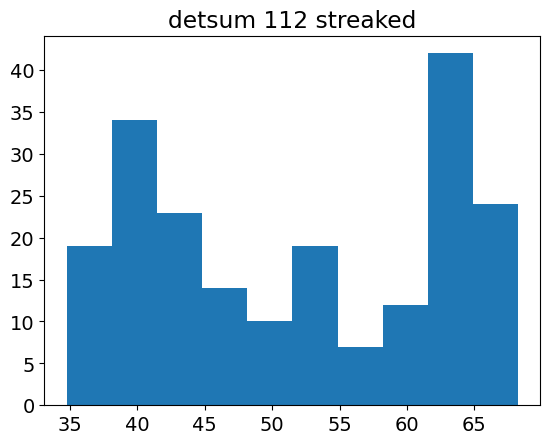

Text(0.5, 1.0, 'maxim 112 streaked')

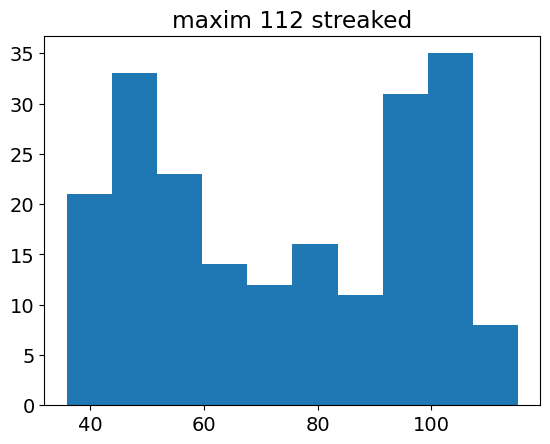

In [60]:
plt.hist(np.array(detsum)/1e6)
plt.title('detsum 112 streaked')
plt.show()
plt.hist(maxim)
plt.title('maxim 112 streaked')

In [61]:
resid2 = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/bg_run_112_Jul27.npy')
quads2 = cv2.warpPerspective(make_quads([0.92, 0.92837547, 0.93816438, 0.96240218]),MM,(1024,1024))

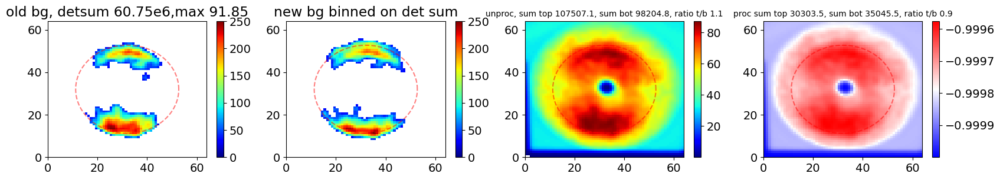

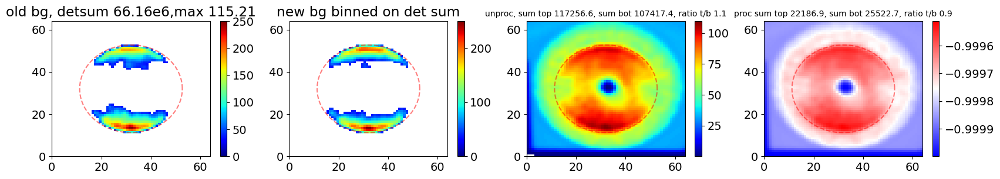

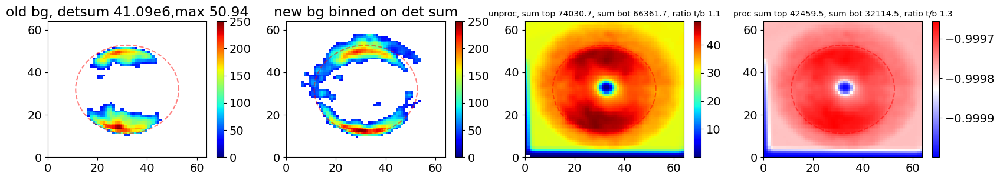

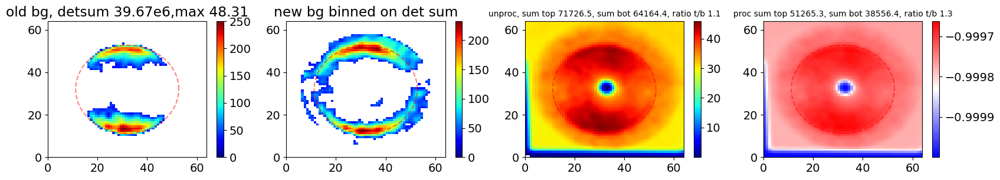

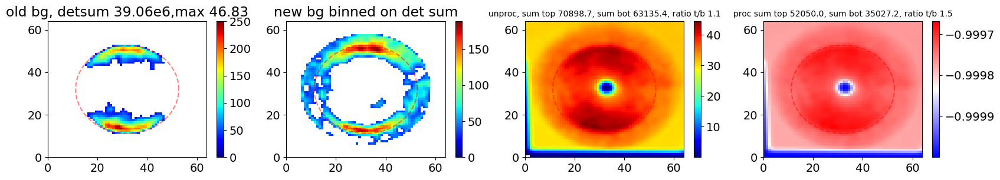

...

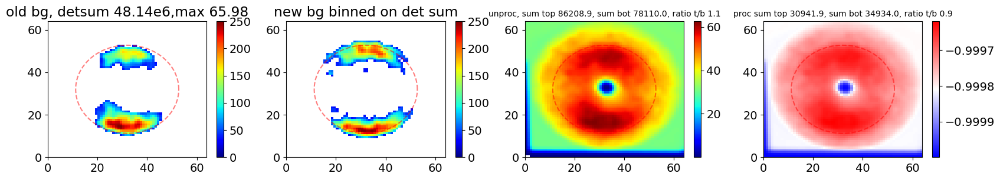

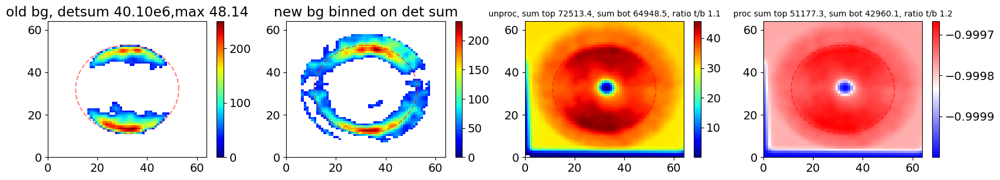

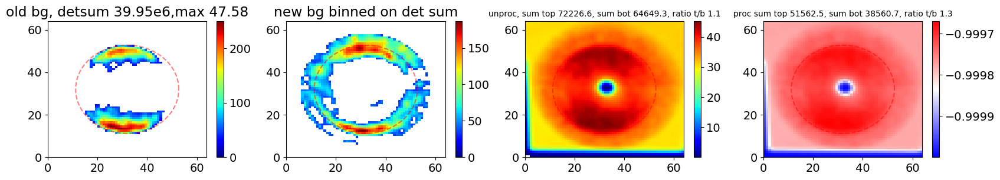

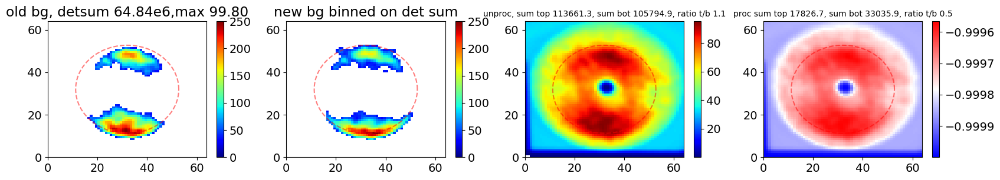

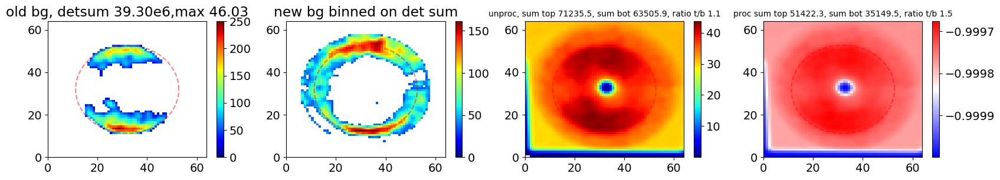

In [62]:
phi_rad = np.linspace(0,360,100)*np.pi/180

for i in range(len(specs)):
    fig,axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,3))
    c = cVMIs[i]
    c[c<0] = 0
    cVMIs[i] = c
    p =axs[0].pcolormesh(c, cmap = my_cmap)
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar(p,ax = axs[0])
    #axs[0].set_title('detsum %1.2fe6, max %1.2f' %(detsum[i]/1e6,maxim[i]))
    axs[0].set_title('old bg, detsum %1.2fe6,max %1.2f' %(detsum[i]/1e6,maxim[i]))
    
    ims = unproc[i]*quads2
    ims[ims<0] = 0
    ims2 = np.copy(ims)
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    resid_scale = resid2/np.mean(resid2*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
    p = axs[2].pcolormesh(ims2, cmap = my_cmap)
    axs[2].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar(p,ax = axs[2])
    bottom = ims2[:32,:]
    top = ims2[32:,:]
    axs[2].set_title('unproc, sum top %1.1f, sum bot %1.1f, ratio t/b %1.1f' %(np.sum(top),np.sum(bottom),np.sum(top)/np.sum(bottom)), fontsize = 10)
    
    p3 = axs[3].pcolormesh(ims2/np.sum(ims2) - avg_unstreak/np.sum(avg_unstreak), cmap = 'bwr')
    
    ims2 = ims2 - resid_scale
    ims2 = gf(ims2,.25)
    ims2 = ims2*rebin(rebin(maskhm*fanmask,4),4)*250/np.max(ims2)

    ims2[ims2<thresh] = 0
    p =axs[1].pcolormesh(ims2, cmap = my_cmap)
    axs[1].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar(p,ax = axs[1])
    axs[1].set_title('new bg binned on det sum')
    bottom = ims2[:32,:]
    top = ims2[32:,:]
    axs[3].set_title('proc sum top %1.1f, sum bot %1.1f, ratio t/b %1.1f' %(np.sum(top),np.sum(bottom),np.sum(top)/np.sum(bottom)), fontsize = 10)
    axs[3].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar(p3,ax = axs[3])
    
    plt.show()

In [51]:
#Check unstreaked
exp =  "tmox51020" #"tmoly9120" #'tmox45719'
gas_jet = 1
print_at = 20
runnum = 112 #112 #106 #93 #76 #73
gmd_min = 0.12 #0.15
gmd_max = 25

In [52]:
nn = 0
ds = ps.DataSource(exp=exp, run=runnum)
run = next(ds.runs())

if hasattr(run, 'epicsinfo'):
    epics_strs = [item[0] for item in run.epicsinfo.keys()][1:] # first one is weird
    epics_detectors = [run.Detector(item) for item in epics_strs]    


# specify detectors here
opal1 = run.Detector('tmo_opal1') # OPAL camera looking at the holey mirror
gmd = run.Detector("gmd") # gas intensity detector 
xgmd = run.Detector("xgmd") # gas intensity detector 
timing = run.Detector('timing') # this gives access to evr codes
ebeam = run.Detector("ebeam")
opalfzp = run.Detector('tmo_fzpopal') 



ims_bg = [] # initialize the list of example images here
GDs_bg = []
xGDs_bg = []
detsum = []
specs = []
jet_timing_bg = []


for nevent, event in enumerate(run.events()): # loop over events (shots) in the run

    # fetch the information from the different events
    opal1im_i=np.copy(opal1.raw.raw(event))
    #opal1im_i=np.copy(opal1.raw.image(event)) #doesn't work since update
    gd_i=gmd.raw.energy(event)
    xgd_i=xgmd.raw.energy(event)
    evr=timing.raw.eventcodes(event)
    L3 = ebeam.raw.ebeamL3Energy(event)

    # identify relevant event codes
    gas=evr[70] # did the gas jet fire
    ir_timed=evr[67] # was the ir laser timed
    ir_misttimed=evr[68] # was the ir laser mis-timed

    
    #if opal1im_i is None or gd_i is None or gd_i<gmd_min or (gas != gas_jet): continue
    if opal1im_i is None or gd_i is None or gd_i>gmd_max or gd_i<gmd_min or (gas != gas_jet): continue
    #if np.sum(opal1im_i*mask) < 37e6: continue
    #if np.sum(opal1im_i*mask) > 40e6: continue
    #if np.sum(opal1im_i*mask) < 42e6: continue
    #if event.timestamp < 4410498451167543084: continue
    #if np.sum(opal1im_i) < 46e6: continue
    
    data = {'epics_'+epic_str: epic_det(event) for epic_str, epic_det in zip(epics_strs, epics_detectors)}        
    if any(type(val) not in [int, float] for val in data.values()):
        print("Bad EPICS: %d" % nevent)
        #Nbad += 1
        continue
        
        
    if ir_misttimed:
        ims = np.rot90(opal1im_i*mask)
        #ims = ims/np.sum(ims)
        #ims = cv2.warpPerspective(ims,MM,(1024,1024))
        #ims_bg.append(ims[100:900,100:900])
        detsum.append(np.sum(opal1im_i))
        ims_bg.append(ims)
        GDs_bg.append(gd_i)
        xGDs_bg.append(xgd_i)
        jet_timing_bg.append(data['epics_evr_ch0_delay'])
        
        opalfz= np.copy(opalfzp.raw.image(event)) #np.copy(opal1.raw.image(event)) #np.copy(opal1.raw.raw(event))
        zps_data = opalfz
        zps_pixel = 100+np.argmax(np.sum(zps_data[100:900],axis=1))
        px_2d_width = 25 #spacing to cut the 2d image slice to store. Typically 50 pixel width. 25 on either side
        px_edge_width = 5 #spacing to integrate for the line out. 

        zps_2d = zps_data[zps_pixel-px_2d_width:zps_pixel+px_2d_width][:]
        zps = zps_data[zps_pixel-px_edge_width:zps_pixel+px_edge_width][:].mean(0)#
        zps_bg = zps_data[zps_pixel-px_2d_width:zps_pixel-px_2d_width+px_edge_width][:].mean(0)#
        zps = zps-zps_bg
        spec = np.squeeze(fastsmooth1(zps,10))
        spec = np.array(np.squeeze(spec) - np.mean(np.squeeze(spec)[800:900])) 
        specs.append(spec)
        
        nn +=1
        
        
    

    if nn%20 == 0:
        print('gathered: %1.0f' %nn)
        
    if len(ims_bg) > 100:
        break
print(event.datetime())   

Bad EPICS: 0
Bad EPICS: 1
Bad EPICS: 3
Bad EPICS: 6
Bad EPICS: 7
Bad EPICS: 9
Bad EPICS: 10
Bad EPICS: 11
Bad EPICS: 12
Bad EPICS: 13
Bad EPICS: 15
Bad EPICS: 16
Bad EPICS: 17
Bad EPICS: 18
Bad EPICS: 19
Bad EPICS: 20
Bad EPICS: 22
Bad EPICS: 23
Bad EPICS: 25
Bad EPICS: 26
Bad EPICS: 27
Bad EPICS: 29
Bad EPICS: 31
Bad EPICS: 32
Bad EPICS: 33
Bad EPICS: 35
Bad EPICS: 37
Bad EPICS: 38
Bad EPICS: 39
Bad EPICS: 40
Bad EPICS: 41
Bad EPICS: 42
Bad EPICS: 43
Bad EPICS: 45
Bad EPICS: 46
Bad EPICS: 48
Bad EPICS: 49
Bad EPICS: 50
Bad EPICS: 51
Bad EPICS: 53
Bad EPICS: 55
gathered: 0
gathered: 20
gathered: 20
gathered: 20
gathered: 20
gathered: 20
gathered: 40
gathered: 40
gathered: 40
gathered: 40
gathered: 40
gathered: 60
gathered: 60
gathered: 60
gathered: 60
gathered: 60
gathered: 60
gathered: 80
gathered: 80
gathered: 80
gathered: 80
gathered: 80
gathered: 80
gathered: 100
gathered: 100
gathered: 100
gathered: 100
gathered: 100
gathered: 100
gathered: 100
2022-07-17 07:42:38.350594


In [53]:
avg_unstreak = np.mean(ims)

(array([55., 14.,  7.,  8.,  4.,  5.,  1.,  1.,  2.,  4.]),
 array([34.002499, 37.13721 , 40.271921, 43.406632, 46.541343, 49.676054,
        52.810765, 55.945476, 59.080187, 62.214898, 65.349609]),
 <BarContainer object of 10 artists>)

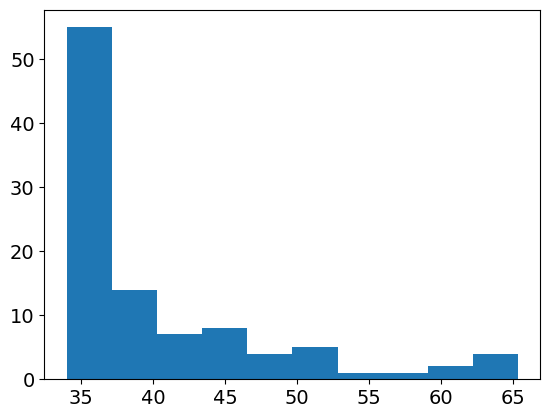

In [21]:
plt.hist(np.array(detsum)/1e6)

In [22]:
imsM = [cv2.warpPerspective(ii,MM,(1024,1024)) for ii in ims_bg]
imsM = np.array(imsM)

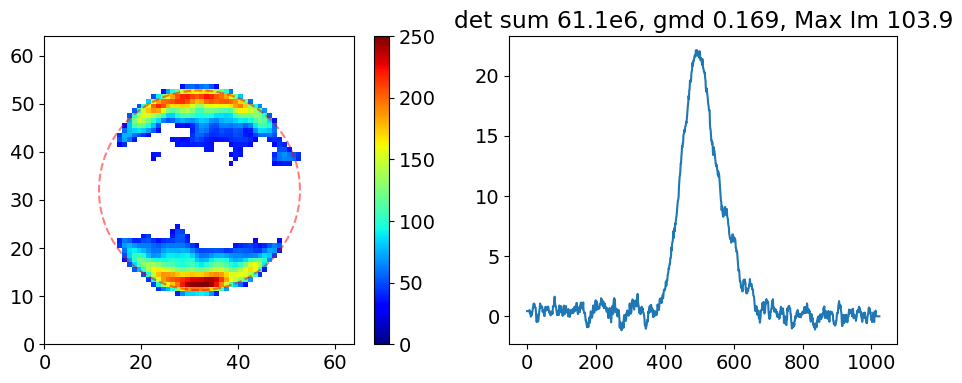

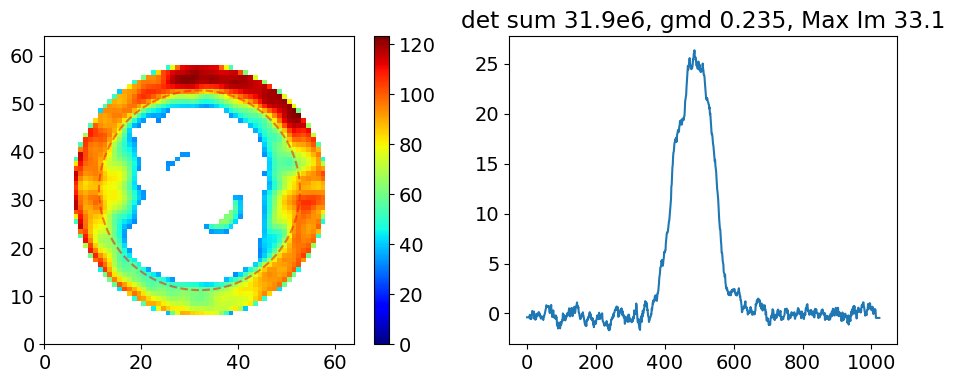

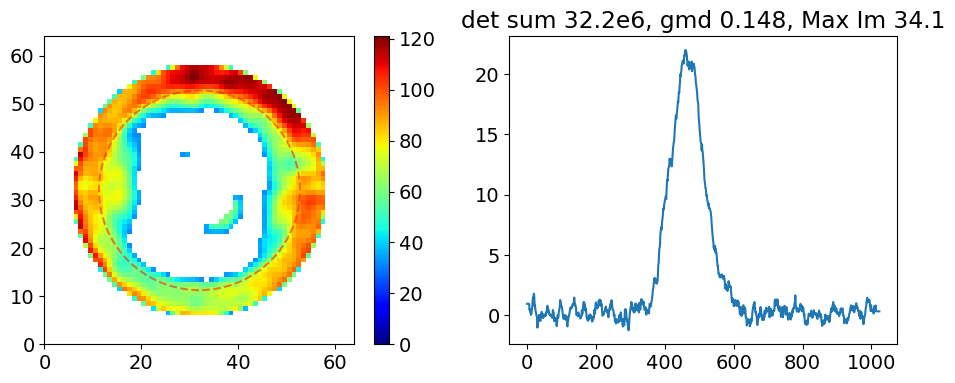

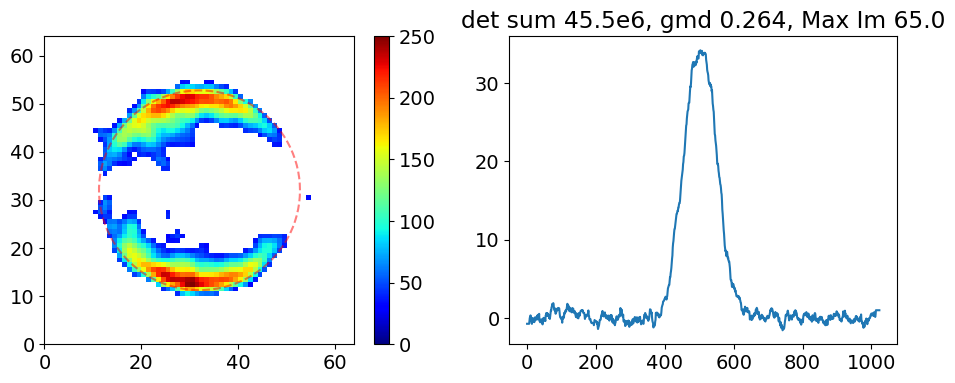

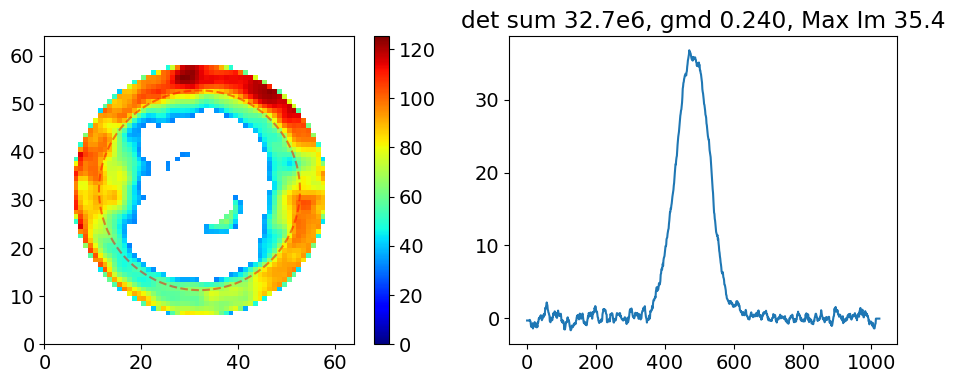

...

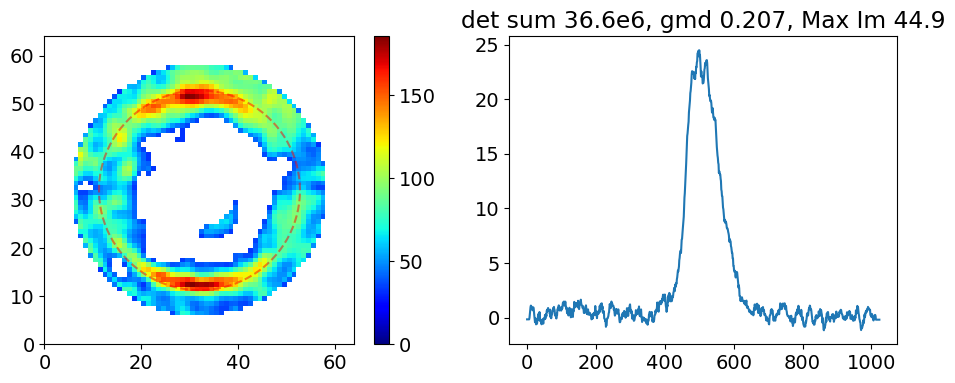

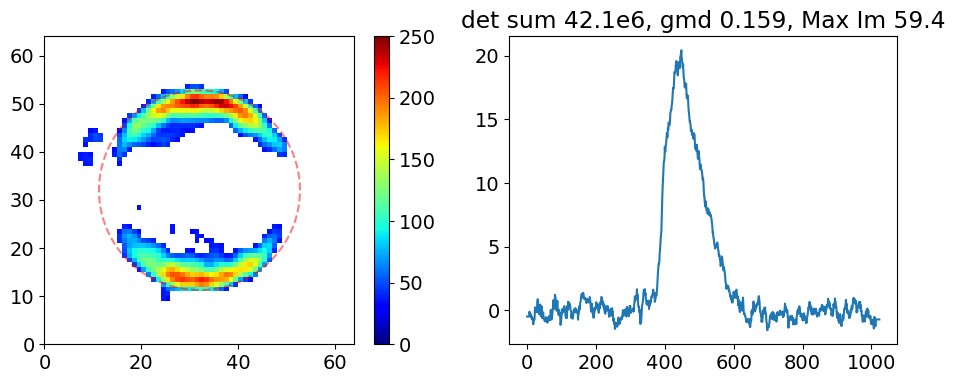

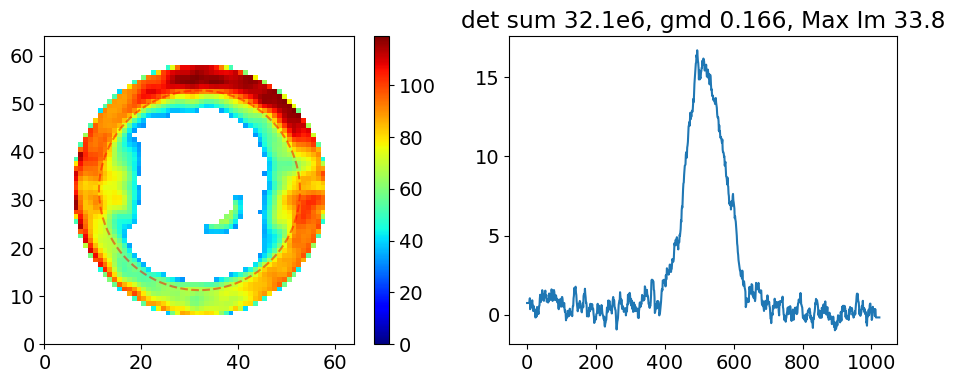

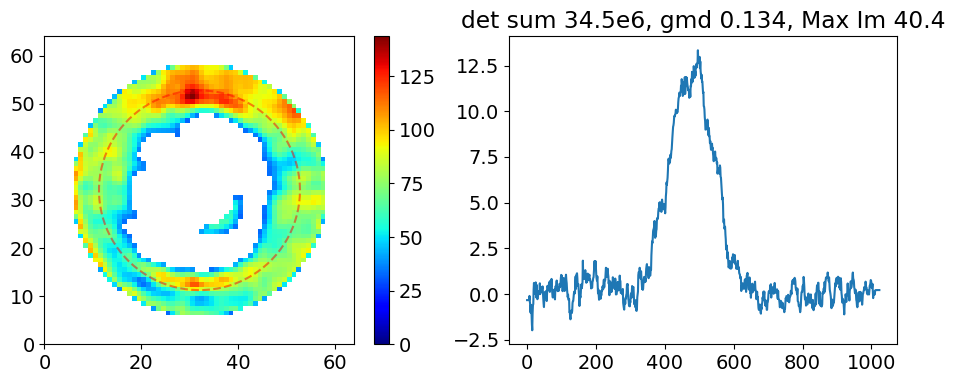

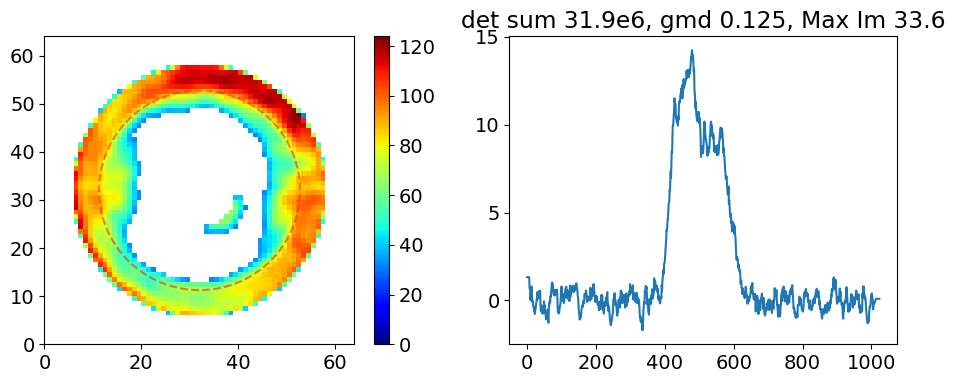

In [23]:
for i in range(60):
    ims2 = imsM[i]*quads
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)

    m = np.max(ims2) #when making dipole bg
    resid_scale = resid2/np.mean(resid2*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))

    ims2 = ims2 - resid_scale*0.98
    ims2 = gf(ims2,.25)
   
    
    ims2 = ims2*rebin(rebin(maskhm,4),4)*250/np.max(ims2)
    ims2[ims2<thresh] = 0
    fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (11,4))
    p = axs[0].pcolormesh(ims2, cmap = my_cmap)
    plt.colorbar(p, ax = axs[0])
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    axs[1].plot(specs[i])
    plt.title('det sum %1.1fe6, gmd %1.3f, Max Im %1.1f' %(np.sum(imsM[i]/1e6), GDs_bg[i], m))
    #plt.colorbar()
    plt.show()